In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

import tensorflow_addons as tfa
import tensorflow_datasets as tfds

from tensorflow.keras.utils import plot_model

tfds.disable_progress_bar()
autotune = tf.data.experimental.AUTOTUNE


In [3]:
# Load the monet-photo dataset using tensorflow-datasets.
dataset, _ = tfds.load("cycle_gan/monet2photo", with_info=True, as_supervised=True,
                      data_dir="D:\WorkStudy\Coding\ComputerVision\Project\datasets")
train_monet, train_photo = dataset["trainA"], dataset["trainB"]
test_monet, test_photo = dataset["testA"], dataset["testB"]


ExtractError: Error while extracting D:\WorkStudy\Coding\ComputerVision\Project\datasets\downloads\peop.eecs.berk.edu_taes_park_Cycl_data_monytvHGnuDwbfKvo3Z7rhyL6lW0LZBr8O9DVdYERQZKcQ.zip to D:\WorkStudy\Coding\ComputerVision\Project\datasets\downloads\extracted\ZIP.peop.eecs.berk.edu_taes_park_Cycl_data_monytvHGnuDwbfKvo3Z7rhyL6lW0LZBr8O9DVdYERQZKcQ.zip (file: monet2photo\testB\2014-12-10 12:08:40.jpg) : Failed to create a NewWriteableFile: D:\WorkStudy\Coding\ComputerVision\Project\datasets\downloads\extracted\ZIP.peop.eecs.berk.edu_taes_park_Cycl_data_monytvHGnuDwbfKvo3Z7rhyL6lW0LZBr8O9DVdYERQZKcQ.zip.incomplete_c7f66b9daaa44892bdd606aa4f23517a\monet2photo\testB\2014-12-10 12:08:40.jpg : The filename, directory name, or volume label syntax is incorrect.
; no protocol option
On windows, path lengths greater than 260 characters may result in an error. See the doc to remove the limitation: https://docs.python.org/3/using/windows.html#removing-the-max-path-limitation

In [11]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

datagen = ImageDataGenerator()

# train_monet = datagen.flow_from_directory('D:/WorkStudy/Coding/ComputerVision/Project/monet2photo/trainA',
#                                          target_size=(286, 286))
train_monet = tf.keras.preprocessing.image_dataset_from_directory(
  "D:/WorkStudy/Coding/ComputerVision/Project/monet2photo/trainA")

Found 0 files belonging to 0 classes.


TypeError: Input 'filename' of 'ReadFile' Op has type float32 that does not match expected type of string.

In [4]:
# Define the standard image size.
orig_img_size = (286, 286)
# Size of the random crops to be used during training.
input_img_size = (256, 256, 3)
# Weights initializer for the layers.
kernel_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# Gamma initializer for instance normalization.
gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

buffer_size = 256
batch_size = 1


def normalize_img(img):
    img = tf.cast(img, dtype=tf.float32)
    # Map values in the range [-1, 1]
    return (img / 127.5) - 1.0


def preprocess_train_image(img, label):
    # Random flip
    img = tf.image.random_flip_left_right(img)
    # Resize to the original size first
    img = tf.image.resize(img, [*orig_img_size])
    # Random crop to 256X256
    img = tf.image.random_crop(img, size=[*input_img_size])
    # Normalize the pixel values in the range [-1, 1]
    img = normalize_img(img)
    return img


def preprocess_test_image(img, label):
    # Only resizing and normalization for the test images.
    img = tf.image.resize(img, [input_img_size[0], input_img_size[1]])
    img = normalize_img(img)
    return img


In [5]:

# Apply the preprocessing operations to the training data
train_monet = (
    train_monet.map(preprocess_train_image, num_parallel_calls=autotune)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)
train_photo = (
    train_photo.map(preprocess_train_image, num_parallel_calls=autotune)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)

# Apply the preprocessing operations to the test data
test_monet = (
    test_monet.map(preprocess_test_image, num_parallel_calls=autotune)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)
test_photo = (
    test_photo.map(preprocess_test_image, num_parallel_calls=autotune)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)


NameError: name 'train_monet' is not defined

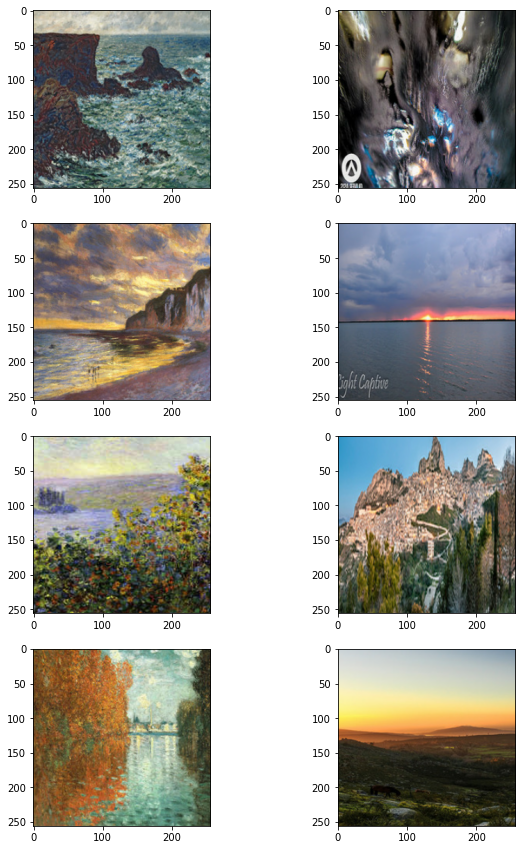

In [6]:

_, ax = plt.subplots(4, 2, figsize=(10, 15))
for i, samples in enumerate(zip(train_monet.take(4), train_photo.take(4))):
    monet = (((samples[0][0] * 127.5) + 127.5).numpy()).astype(np.uint8)
    photo = (((samples[1][0] * 127.5) + 127.5).numpy()).astype(np.uint8)
    ax[i, 0].imshow(monet)
    ax[i, 1].imshow(photo)
plt.show()


In [5]:

class ReflectionPadding2D(layers.Layer):
    """Implements Reflection Padding as a layer.

    Args:
        padding(tuple): Amount of padding for the
        spatial dimensions.

    Returns:
        A padded tensor with the same type as the input tensor.
    """

    def __init__(self, padding=(1, 1), **kwargs):
        self.padding = tuple(padding)
        super(ReflectionPadding2D, self).__init__(**kwargs)

    def call(self, input_tensor, mask=None):
        padding_width, padding_height = self.padding
        padding_tensor = [
            [0, 0],
            [padding_height, padding_height],
            [padding_width, padding_width],
            [0, 0],
        ]
        return tf.pad(input_tensor, padding_tensor, mode="REFLECT")


def residual_block(
    x,
    activation,
    kernel_initializer=kernel_init,
    kernel_size=(3, 3),
    strides=(1, 1),
    padding="valid",
    gamma_initializer=gamma_init,
    use_bias=False,
):
    dim = x.shape[-1]
    input_tensor = x

    x = ReflectionPadding2D()(input_tensor)
    x = layers.Conv2D(
        dim,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    x = activation(x)

    x = ReflectionPadding2D()(x)
    x = layers.Conv2D(
        dim,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    x = layers.add([input_tensor, x])
    return x


def downsample(
    x,
    filters,
    activation,
    kernel_initializer=kernel_init,
    kernel_size=(3, 3),
    strides=(2, 2),
    padding="same",
    gamma_initializer=gamma_init,
    use_bias=False,
):
    x = layers.Conv2D(
        filters,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    if activation:
        x = activation(x)
    return x


def upsample(
    x,
    filters,
    activation,
    kernel_size=(3, 3),
    strides=(2, 2),
    padding="same",
    kernel_initializer=kernel_init,
    gamma_initializer=gamma_init,
    use_bias=False,
):
    x = layers.Conv2DTranspose(
        filters,
        kernel_size,
        strides=strides,
        padding=padding,
        kernel_initializer=kernel_initializer,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    if activation:
        x = activation(x)
    return x


In [6]:

def get_resnet_generator(
    filters=64,
    num_downsampling_blocks=2,
    num_residual_blocks=9,
    num_upsample_blocks=2,
    gamma_initializer=gamma_init,
    name=None,
):
    img_input = layers.Input(shape=input_img_size, name=name + "_img_input")
    x = ReflectionPadding2D(padding=(3, 3))(img_input)
    x = layers.Conv2D(filters, (7, 7), kernel_initializer=kernel_init, use_bias=False)(
        x
    )
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    x = layers.Activation("relu")(x)

    # Downsampling
    for _ in range(num_downsampling_blocks):
        filters *= 2
        x = downsample(x, filters=filters, activation=layers.Activation("relu"))

    # Residual blocks
    for _ in range(num_residual_blocks):
        x = residual_block(x, activation=layers.Activation("relu"))

    # Upsampling
    for _ in range(num_upsample_blocks):
        filters //= 2
        x = upsample(x, filters, activation=layers.Activation("relu"))

    # Final block
    x = ReflectionPadding2D(padding=(3, 3))(x)
    x = layers.Conv2D(3, (7, 7), padding="valid")(x)
    x = layers.Activation("tanh")(x)

    model = keras.models.Model(img_input, x, name=name)
    return model


In [7]:

def get_discriminator(
    filters=64, kernel_initializer=kernel_init, num_downsampling=3, name=None
):
    img_input = layers.Input(shape=input_img_size, name=name + "_img_input")
    x = layers.Conv2D(
        filters,
        (4, 4),
        strides=(2, 2),
        padding="same",
        kernel_initializer=kernel_initializer,
    )(img_input)
    x = layers.LeakyReLU(0.2)(x)

    num_filters = filters
    for num_downsample_block in range(3):
        num_filters *= 2
        if num_downsample_block < 2:
            x = downsample(
                x,
                filters=num_filters,
                activation=layers.LeakyReLU(0.2),
                kernel_size=(4, 4),
                strides=(2, 2),
            )
        else:
            x = downsample(
                x,
                filters=num_filters,
                activation=layers.LeakyReLU(0.2),
                kernel_size=(4, 4),
                strides=(1, 1),
            )

    x = layers.Conv2D(
        1, (4, 4), strides=(1, 1), padding="same", kernel_initializer=kernel_initializer
    )(x)

    model = keras.models.Model(inputs=img_input, outputs=x, name=name)
    return model


# Get the generators
gen_G = get_resnet_generator(name="generator_G")
gen_F = get_resnet_generator(name="generator_F")

# Get the discriminators
disc_X = get_discriminator(name="discriminator_X")
disc_Y = get_discriminator(name="discriminator_Y")


Model: "generator_G"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
generator_G_img_input (InputLay [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
reflection_padding2d (Reflectio (None, 262, 262, 3)  0           generator_G_img_input[0][0]      
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 256, 256, 64) 9408        reflection_padding2d[0][0]       
__________________________________________________________________________________________________
instance_normalization (Instanc (None, 256, 256, 64) 128         conv2d[0][0]                     
________________________________________________________________________________________

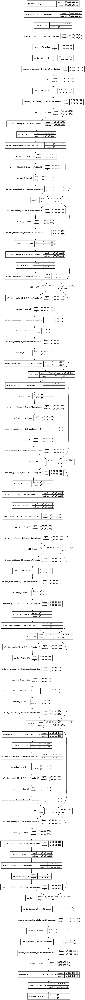

In [ ]:
# summarize the model
gen_G.summary()
# plot the model
plot_model(gen_G, to_file='/content/drive/MyDrive/CycleGAN/generator_G_model_plot.png', show_shapes=True, show_layer_names=True)

Model: "generator_F"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
generator_F_img_input (InputLay [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
reflection_padding2d_20 (Reflec (None, 262, 262, 3)  0           generator_F_img_input[0][0]      
__________________________________________________________________________________________________
conv2d_22 (Conv2D)              (None, 256, 256, 64) 9408        reflection_padding2d_20[0][0]    
__________________________________________________________________________________________________
instance_normalization_23 (Inst (None, 256, 256, 64) 128         conv2d_22[0][0]                  
________________________________________________________________________________________

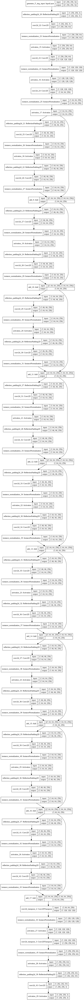

In [ ]:
# summarize the model
gen_F.summary()
# plot the model
plot_model(gen_F, to_file='/content/drive/MyDrive/CycleGAN/generator_F_model_plot.png', show_shapes=True, show_layer_names=True)

Model: "discriminator_X"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
discriminator_X_img_input (I [(None, 256, 256, 3)]     0         
_________________________________________________________________
conv2d_44 (Conv2D)           (None, 128, 128, 64)      3136      
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 128, 128, 64)      0         
_________________________________________________________________
conv2d_45 (Conv2D)           (None, 64, 64, 128)       131072    
_________________________________________________________________
instance_normalization_46 (I (None, 64, 64, 128)       256       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 64, 64, 128)       0         
_________________________________________________________________
conv2d_46 (Conv2D)           (None, 32, 32, 256)   

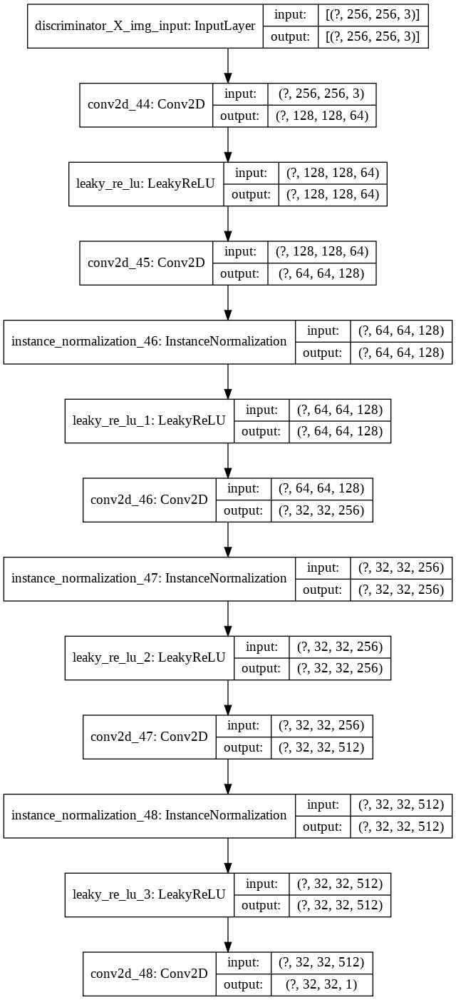

In [ ]:
# summarize the model
disc_X.summary()
# plot the model
plot_model(disc_X, to_file='/content/drive/MyDrive/CycleGAN/discriminator_X_model_plot.png', show_shapes=True, show_layer_names=True)

Model: "discriminator_Y"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
discriminator_Y_img_input (I [(None, 256, 256, 3)]     0         
_________________________________________________________________
conv2d_49 (Conv2D)           (None, 128, 128, 64)      3136      
_________________________________________________________________
leaky_re_lu_4 (LeakyReLU)    (None, 128, 128, 64)      0         
_________________________________________________________________
conv2d_50 (Conv2D)           (None, 64, 64, 128)       131072    
_________________________________________________________________
instance_normalization_49 (I (None, 64, 64, 128)       256       
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 64, 64, 128)       0         
_________________________________________________________________
conv2d_51 (Conv2D)           (None, 32, 32, 256)   

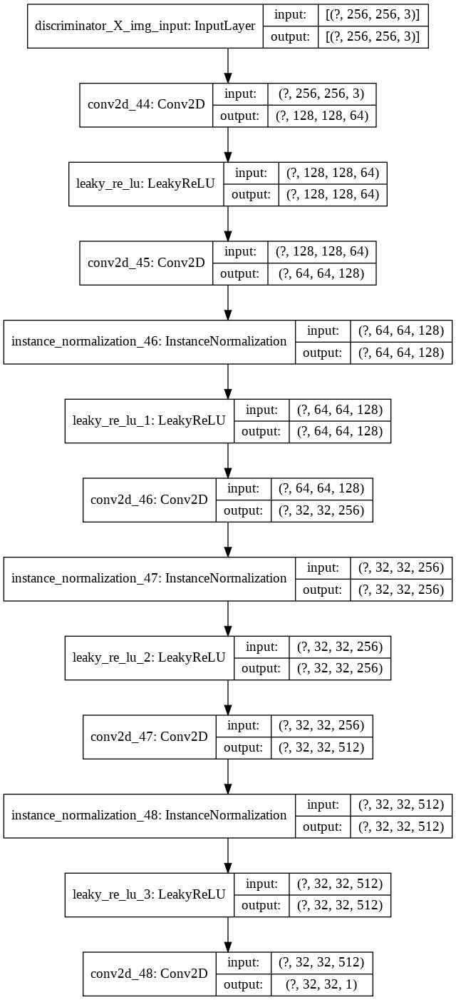

In [ ]:
# summarize the model
disc_Y.summary()
# plot the model
plot_model(disc_X, to_file='/content/drive/MyDrive/CycleGAN/discriminator_Y_model_plot.png', show_shapes=True, show_layer_names=True)

In [8]:

class CycleGan(keras.Model):
    def __init__(
        self,
        generator_G,
        generator_F,
        discriminator_X,
        discriminator_Y,
        lambda_cycle=15.0,
        lambda_identity=0.5,
    ):
        super(CycleGan, self).__init__()
        self.gen_G = generator_G
        self.gen_F = generator_F
        self.disc_X = discriminator_X
        self.disc_Y = discriminator_Y
        self.lambda_cycle = lambda_cycle
        self.lambda_identity = lambda_identity

    def compile(
        self,
        gen_G_optimizer,
        gen_F_optimizer,
        disc_X_optimizer,
        disc_Y_optimizer,
        gen_loss_fn,
        disc_loss_fn,
    ):
        super(CycleGan, self).compile()
        self.gen_G_optimizer = gen_G_optimizer
        self.gen_F_optimizer = gen_F_optimizer
        self.disc_X_optimizer = disc_X_optimizer
        self.disc_Y_optimizer = disc_Y_optimizer
        self.generator_loss_fn = gen_loss_fn
        self.discriminator_loss_fn = disc_loss_fn
        self.cycle_loss_fn = keras.losses.MeanAbsoluteError()
        self.identity_loss_fn = keras.losses.MeanAbsoluteError()

    def train_step(self, batch_data):
        # x is Horse and y is zebra
        real_x, real_y = batch_data

        # For CycleGAN, we need to calculate different
        # kinds of losses for the generators and discriminators.
        # We will perform the following steps here:
        #
        # 1. Pass real images through the generators and get the generated images
        # 2. Pass the generated images back to the generators to check if we
        #    we can predict the original image from the generated image.
        # 3. Do an identity mapping of the real images using the generators.
        # 4. Pass the generated images in 1) to the corresponding discriminators.
        # 5. Calculate the generators total loss (adverserial + cycle + identity)
        # 6. Calculate the discriminators loss
        # 7. Update the weights of the generators
        # 8. Update the weights of the discriminators
        # 9. Return the losses in a dictionary

        with tf.GradientTape(persistent=True) as tape:
            # Horse to fake zebra
            fake_y = self.gen_G(real_x, training=True)
            # Zebra to fake horse -> y2x
            fake_x = self.gen_F(real_y, training=True)

            # Cycle (Horse to fake zebra to fake horse): x -> y -> x
            cycled_x = self.gen_F(fake_y, training=True)
            # Cycle (Zebra to fake horse to fake zebra) y -> x -> y
            cycled_y = self.gen_G(fake_x, training=True)

            # Identity mapping
            same_x = self.gen_F(real_x, training=True)
            same_y = self.gen_G(real_y, training=True)

            # Discriminator output
            disc_real_x = self.disc_X(real_x, training=True)
            disc_fake_x = self.disc_X(fake_x, training=True)

            disc_real_y = self.disc_Y(real_y, training=True)
            disc_fake_y = self.disc_Y(fake_y, training=True)

            # Generator adverserial loss
            gen_G_loss = self.generator_loss_fn(disc_fake_y)
            gen_F_loss = self.generator_loss_fn(disc_fake_x)

            # Generator cycle loss
            cycle_loss_G = self.cycle_loss_fn(real_y, cycled_y) * self.lambda_cycle
            cycle_loss_F = self.cycle_loss_fn(real_x, cycled_x) * self.lambda_cycle

            # Generator identity loss
            id_loss_G = (
                self.identity_loss_fn(real_y, same_y)
                * self.lambda_cycle
                * self.lambda_identity
            )
            id_loss_F = (
                self.identity_loss_fn(real_x, same_x)
                * self.lambda_cycle
                * self.lambda_identity
            )

            # Total generator loss
            total_loss_G = gen_G_loss + cycle_loss_G + id_loss_G
            total_loss_F = gen_F_loss + cycle_loss_F + id_loss_F

            # Discriminator loss
            disc_X_loss = self.discriminator_loss_fn(disc_real_x, disc_fake_x)
            disc_Y_loss = self.discriminator_loss_fn(disc_real_y, disc_fake_y)

        # Get the gradients for the generators
        grads_G = tape.gradient(total_loss_G, self.gen_G.trainable_variables)
        grads_F = tape.gradient(total_loss_F, self.gen_F.trainable_variables)

        # Get the gradients for the discriminators
        disc_X_grads = tape.gradient(disc_X_loss, self.disc_X.trainable_variables)
        disc_Y_grads = tape.gradient(disc_Y_loss, self.disc_Y.trainable_variables)

        # Update the weights of the generators
        self.gen_G_optimizer.apply_gradients(
            zip(grads_G, self.gen_G.trainable_variables)
        )
        self.gen_F_optimizer.apply_gradients(
            zip(grads_F, self.gen_F.trainable_variables)
        )

        # Update the weights of the discriminators
        self.disc_X_optimizer.apply_gradients(
            zip(disc_X_grads, self.disc_X.trainable_variables)
        )
        self.disc_Y_optimizer.apply_gradients(
            zip(disc_Y_grads, self.disc_Y.trainable_variables)
        )

        return {
            "G_loss": total_loss_G,
            "F_loss": total_loss_F,
            "D_X_loss": disc_X_loss,
            "D_Y_loss": disc_Y_loss,
        }


In [9]:

class GANMonitor(keras.callbacks.Callback):
    """A callback to generate and save images after each epoch"""

    def __init__(self, num_img=4):
        self.num_img = num_img

    def on_epoch_end(self, epoch, logs=None):
        _, ax = plt.subplots(4, 2, figsize=(12, 12))
        for i, img in enumerate(test_monet.take(self.num_img)):
            prediction = self.model.gen_G(img)[0].numpy()
            prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
            img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

            ax[i, 0].imshow(img)
            ax[i, 1].imshow(prediction)
            ax[i, 0].set_title("Input image")
            ax[i, 1].set_title("Translated image")
            ax[i, 0].axis("off")
            ax[i, 1].axis("off")

            prediction = keras.preprocessing.image.array_to_img(prediction)
            prediction.save(
                "generated_img_{i}_{epoch}.png".format(i=i, epoch=epoch + 1)
            )
        plt.show()
        plt.close()


In [10]:
# Loss function for evaluating adversarial loss
adv_loss_fn = keras.losses.MeanSquaredError()

# Define the loss function for the generators
def generator_loss_fn(fake):
    fake_loss = adv_loss_fn(tf.ones_like(fake), fake)
    return fake_loss


# Define the loss function for the discriminators
def discriminator_loss_fn(real, fake):
    real_loss = adv_loss_fn(tf.ones_like(real), real)
    fake_loss = adv_loss_fn(tf.zeros_like(fake), fake)
    return (real_loss + fake_loss) * 0.5


# Create cycle gan model
cycle_gan_model = CycleGan(
    generator_G=gen_G, generator_F=gen_F, discriminator_X=disc_X, discriminator_Y=disc_Y, lambda_cycle=15
)

# Compile the model
cycle_gan_model.compile(
    gen_G_optimizer=keras.optimizers.Adam(learning_rate=5e-4, beta_1=0.5),
    gen_F_optimizer=keras.optimizers.Adam(learning_rate=5e-4, beta_1=0.5),
    disc_X_optimizer=keras.optimizers.Adam(learning_rate=5e-4, beta_1=0.5),
    disc_Y_optimizer=keras.optimizers.Adam(learning_rate=5e-4, beta_1=0.5),
    gen_loss_fn=generator_loss_fn,
    disc_loss_fn=discriminator_loss_fn,
)
# Callbacks
plotter = GANMonitor()
checkpoint_filepath = "/content/drive/MyDrive/CycleGAN/pre-trained/cyclegan_checkpoints.{epoch:03d}"
model_checkpoint_callback = keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath
)


Epoch 1/70
1072/1072 [==============================] - ETA: 0s - G_loss: 6.8266 - F_loss: 6.4879 - D_X_loss: 0.1673 - D_Y_loss: 0.1823

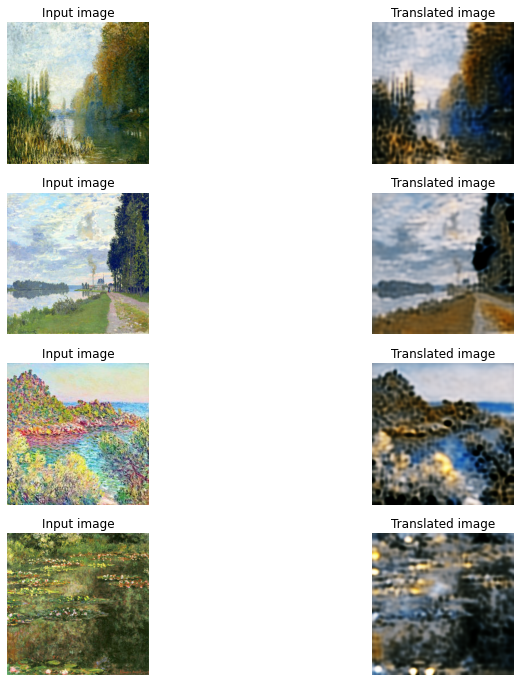

1072/1072 [==============================] - 691s 645ms/step - G_loss: 6.8261 - F_loss: 6.4868 - D_X_loss: 0.1674 - D_Y_loss: 0.1823
Epoch 2/70
1072/1072 [==============================] - ETA: 0s - G_loss: 5.2479 - F_loss: 5.1125 - D_X_loss: 0.2291 - D_Y_loss: 0.2136

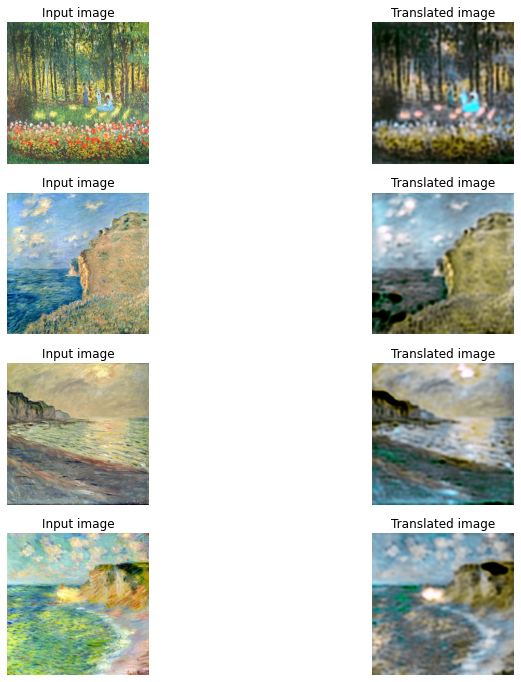

1072/1072 [==============================] - 686s 640ms/step - G_loss: 5.2458 - F_loss: 5.1125 - D_X_loss: 0.2291 - D_Y_loss: 0.2137
Epoch 3/70
1072/1072 [==============================] - ETA: 0s - G_loss: 4.9168 - F_loss: 4.7102 - D_X_loss: 0.2175 - D_Y_loss: 0.2066

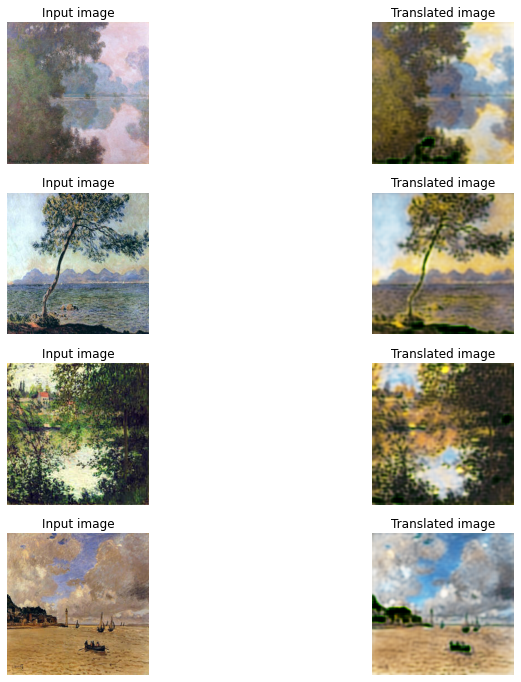

1072/1072 [==============================] - 686s 640ms/step - G_loss: 4.9165 - F_loss: 4.7101 - D_X_loss: 0.2176 - D_Y_loss: 0.2066
Epoch 4/70
1072/1072 [==============================] - ETA: 0s - G_loss: 4.6512 - F_loss: 4.5031 - D_X_loss: 0.2114 - D_Y_loss: 0.2080

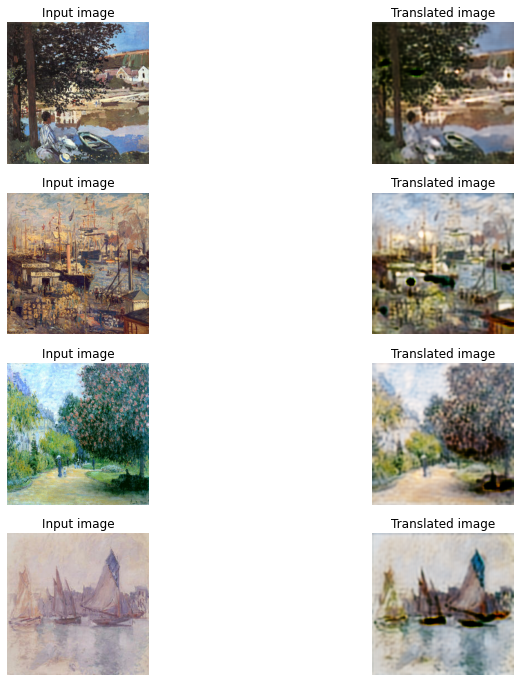

1072/1072 [==============================] - 684s 638ms/step - G_loss: 4.6513 - F_loss: 4.5033 - D_X_loss: 0.2116 - D_Y_loss: 0.2079
Epoch 5/70
1072/1072 [==============================] - ETA: 0s - G_loss: 4.4944 - F_loss: 4.2897 - D_X_loss: 0.2192 - D_Y_loss: 0.1992

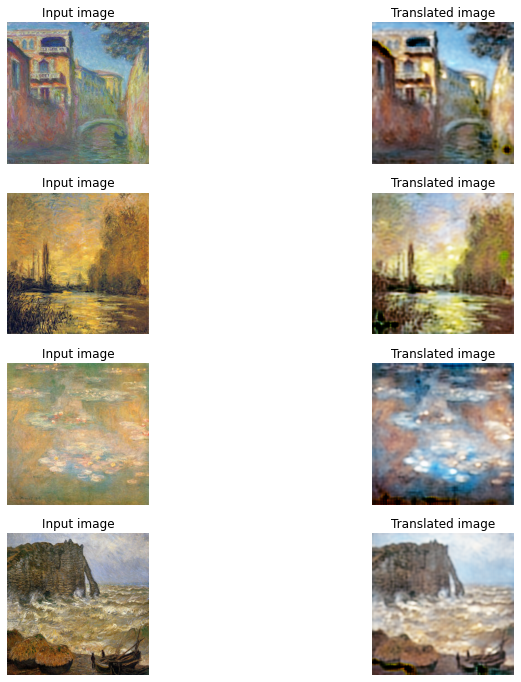

1072/1072 [==============================] - 683s 637ms/step - G_loss: 4.4973 - F_loss: 4.2899 - D_X_loss: 0.2192 - D_Y_loss: 0.1990
Epoch 6/70
1072/1072 [==============================] - ETA: 0s - G_loss: 4.4013 - F_loss: 4.1362 - D_X_loss: 0.2196 - D_Y_loss: 0.1983

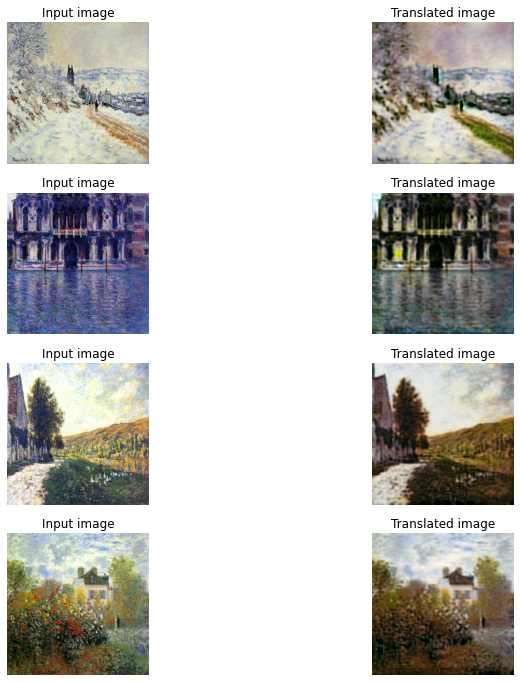

1072/1072 [==============================] - 683s 637ms/step - G_loss: 4.4012 - F_loss: 4.1361 - D_X_loss: 0.2198 - D_Y_loss: 0.1984
Epoch 7/70
1072/1072 [==============================] - ETA: 0s - G_loss: 4.3110 - F_loss: 4.1205 - D_X_loss: 0.2201 - D_Y_loss: 0.1996

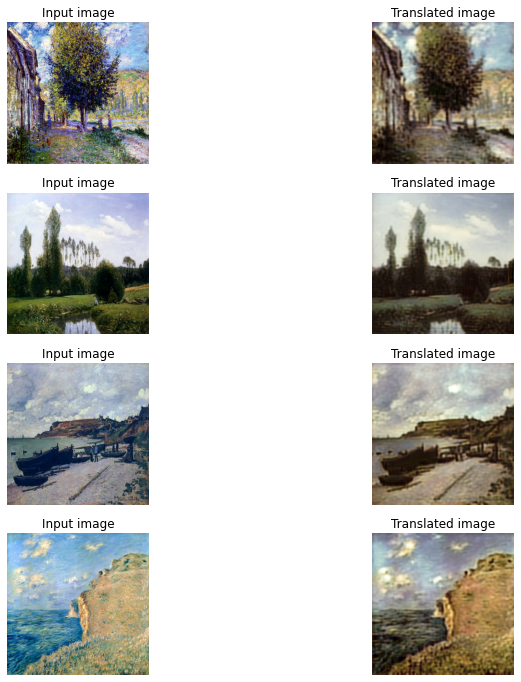

1072/1072 [==============================] - 682s 636ms/step - G_loss: 4.3121 - F_loss: 4.1199 - D_X_loss: 0.2203 - D_Y_loss: 0.1996
Epoch 8/70
1072/1072 [==============================] - ETA: 0s - G_loss: 4.1877 - F_loss: 4.0513 - D_X_loss: 0.2191 - D_Y_loss: 0.1998

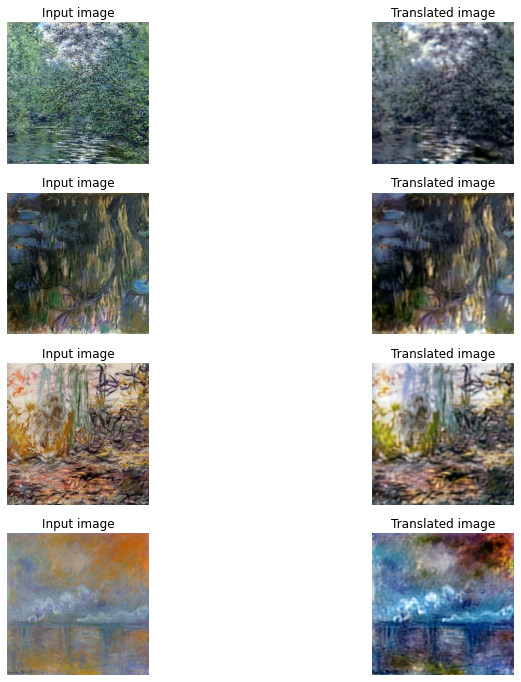

1072/1072 [==============================] - 682s 636ms/step - G_loss: 4.1896 - F_loss: 4.0513 - D_X_loss: 0.2191 - D_Y_loss: 0.1999
Epoch 9/70
1072/1072 [==============================] - ETA: 0s - G_loss: 4.1262 - F_loss: 3.9485 - D_X_loss: 0.2230 - D_Y_loss: 0.2012

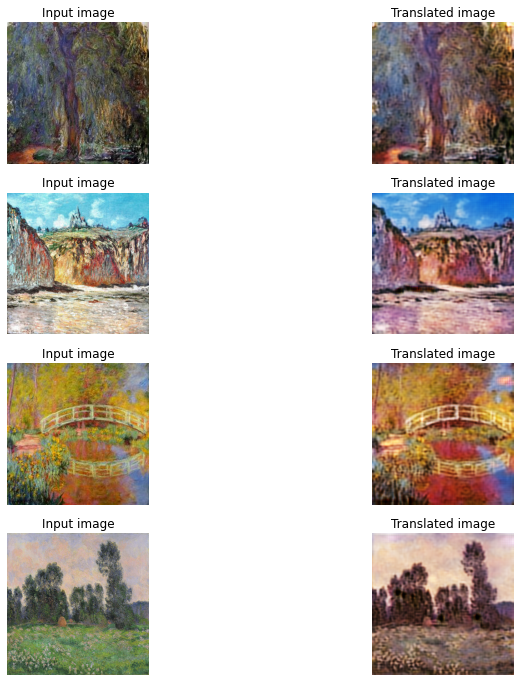

1072/1072 [==============================] - 681s 636ms/step - G_loss: 4.1262 - F_loss: 3.9491 - D_X_loss: 0.2231 - D_Y_loss: 0.2011
Epoch 10/70
1072/1072 [==============================] - ETA: 0s - G_loss: 4.0882 - F_loss: 3.9186 - D_X_loss: 0.2201 - D_Y_loss: 0.1997

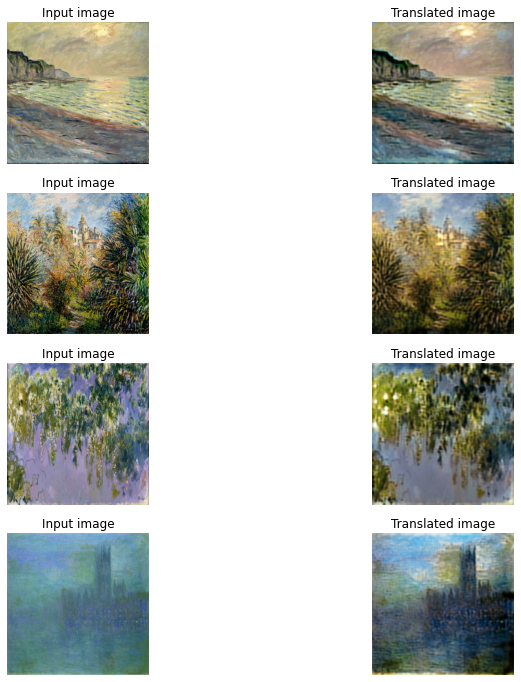

1072/1072 [==============================] - 681s 635ms/step - G_loss: 4.0911 - F_loss: 3.9194 - D_X_loss: 0.2203 - D_Y_loss: 0.1997
Epoch 11/70
1072/1072 [==============================] - ETA: 0s - G_loss: 4.0549 - F_loss: 3.8664 - D_X_loss: 0.2271 - D_Y_loss: 0.2017

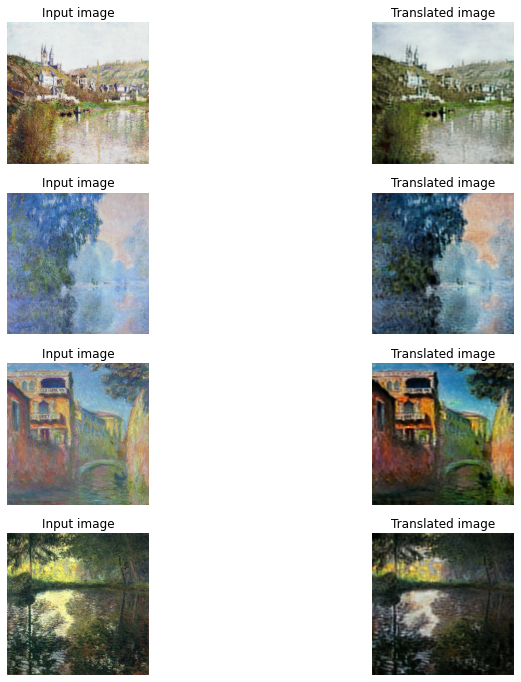

1072/1072 [==============================] - 680s 635ms/step - G_loss: 4.0554 - F_loss: 3.8653 - D_X_loss: 0.2271 - D_Y_loss: 0.2017
Epoch 12/70
1072/1072 [==============================] - ETA: 0s - G_loss: 4.0151 - F_loss: 3.7848 - D_X_loss: 0.2280 - D_Y_loss: 0.2052

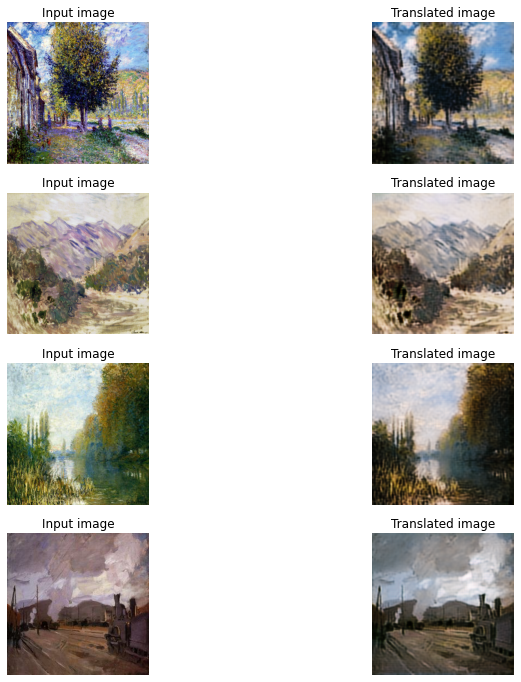

1072/1072 [==============================] - 681s 635ms/step - G_loss: 4.0152 - F_loss: 3.7850 - D_X_loss: 0.2279 - D_Y_loss: 0.2052
Epoch 13/70
1072/1072 [==============================] - ETA: 0s - G_loss: 4.0038 - F_loss: 3.7610 - D_X_loss: 0.2302 - D_Y_loss: 0.2055

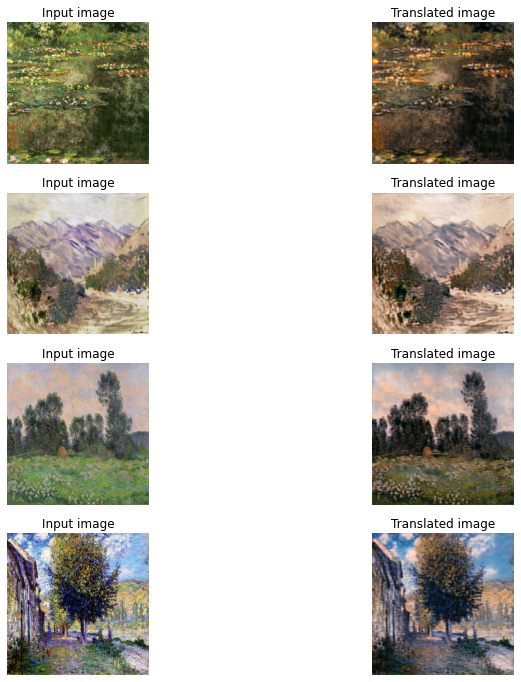

1072/1072 [==============================] - 681s 635ms/step - G_loss: 4.0034 - F_loss: 3.7602 - D_X_loss: 0.2303 - D_Y_loss: 0.2055
Epoch 14/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.9862 - F_loss: 3.6822 - D_X_loss: 0.2310 - D_Y_loss: 0.2034

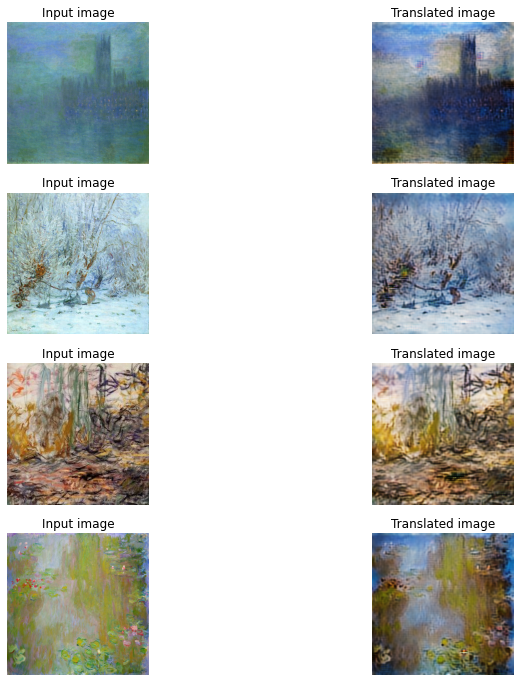

1072/1072 [==============================] - 680s 635ms/step - G_loss: 3.9859 - F_loss: 3.6831 - D_X_loss: 0.2310 - D_Y_loss: 0.2032
Epoch 15/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.8861 - F_loss: 3.6682 - D_X_loss: 0.2342 - D_Y_loss: 0.2102

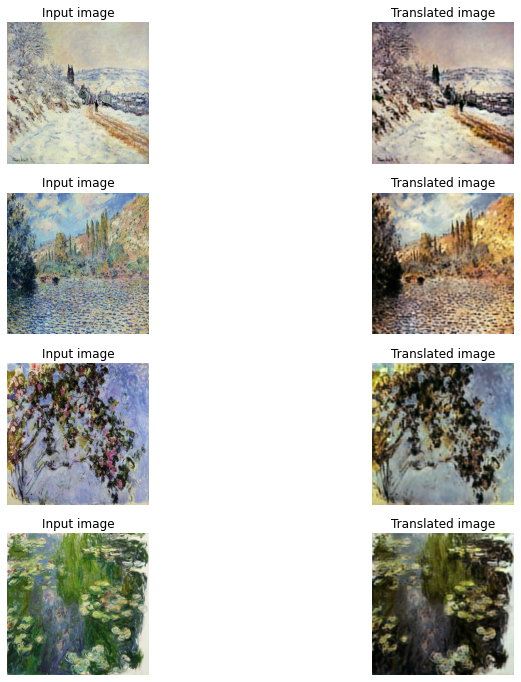

1072/1072 [==============================] - 681s 635ms/step - G_loss: 3.8871 - F_loss: 3.6681 - D_X_loss: 0.2343 - D_Y_loss: 0.2101
Epoch 16/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.8435 - F_loss: 3.6307 - D_X_loss: 0.2322 - D_Y_loss: 0.2060

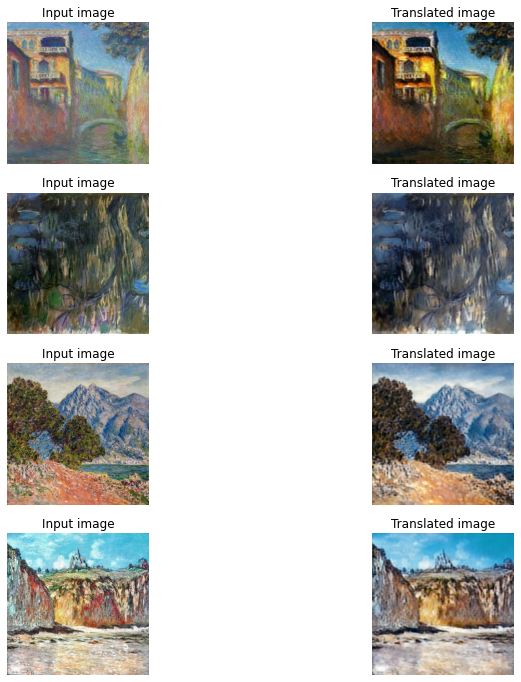

1072/1072 [==============================] - 680s 634ms/step - G_loss: 3.8424 - F_loss: 3.6308 - D_X_loss: 0.2322 - D_Y_loss: 0.2062
Epoch 17/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.9506 - F_loss: 3.5828 - D_X_loss: 0.2323 - D_Y_loss: 0.2046

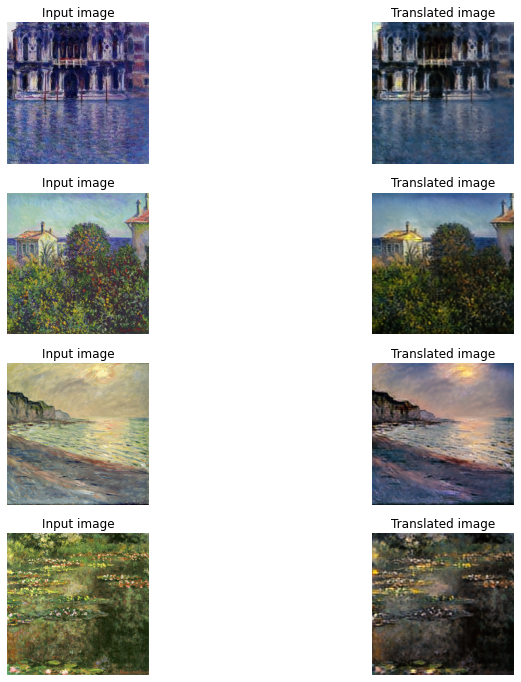

1072/1072 [==============================] - 680s 634ms/step - G_loss: 3.9520 - F_loss: 3.5832 - D_X_loss: 0.2323 - D_Y_loss: 0.2047
Epoch 18/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.7788 - F_loss: 3.5794 - D_X_loss: 0.2338 - D_Y_loss: 0.2084

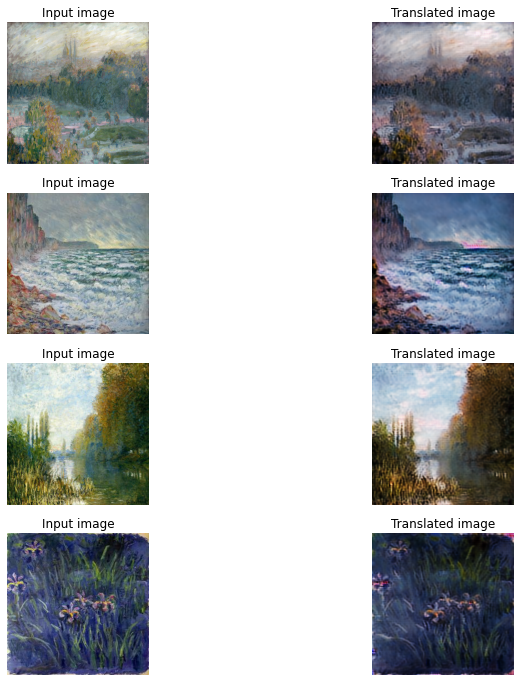

1072/1072 [==============================] - 680s 634ms/step - G_loss: 3.7782 - F_loss: 3.5793 - D_X_loss: 0.2338 - D_Y_loss: 0.2086
Epoch 19/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.7648 - F_loss: 3.5246 - D_X_loss: 0.2331 - D_Y_loss: 0.2098

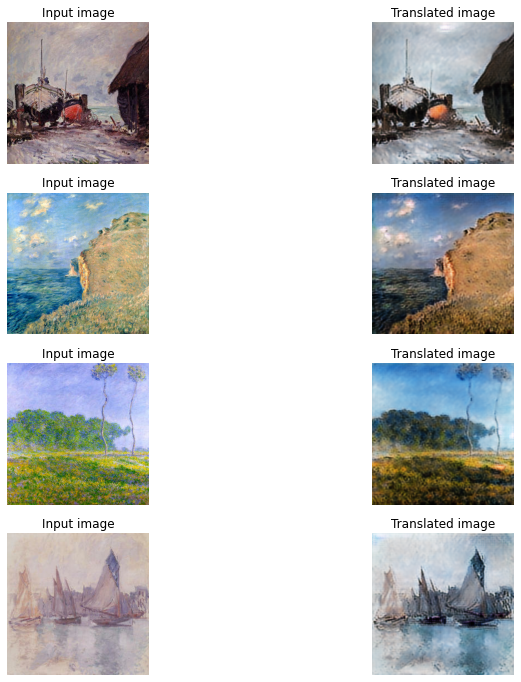

1072/1072 [==============================] - 680s 634ms/step - G_loss: 3.7653 - F_loss: 3.5241 - D_X_loss: 0.2331 - D_Y_loss: 0.2097
Epoch 20/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.8013 - F_loss: 3.4966 - D_X_loss: 0.2338 - D_Y_loss: 0.2043

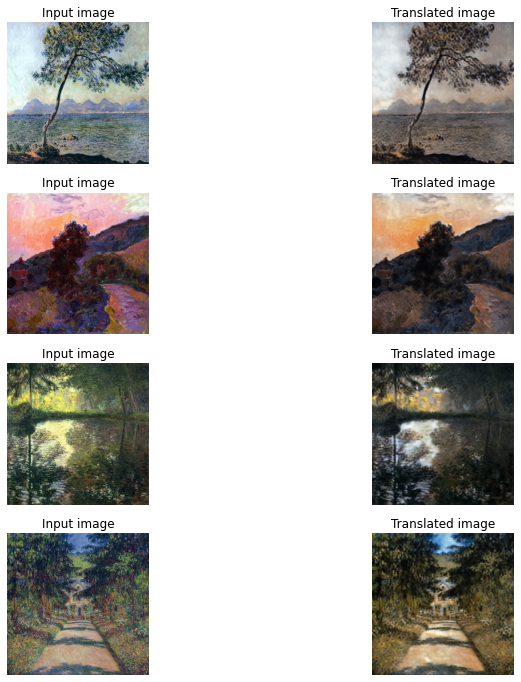

1072/1072 [==============================] - 679s 634ms/step - G_loss: 3.8008 - F_loss: 3.4962 - D_X_loss: 0.2338 - D_Y_loss: 0.2046
Epoch 21/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.7474 - F_loss: 3.4818 - D_X_loss: 0.2351 - D_Y_loss: 0.2050

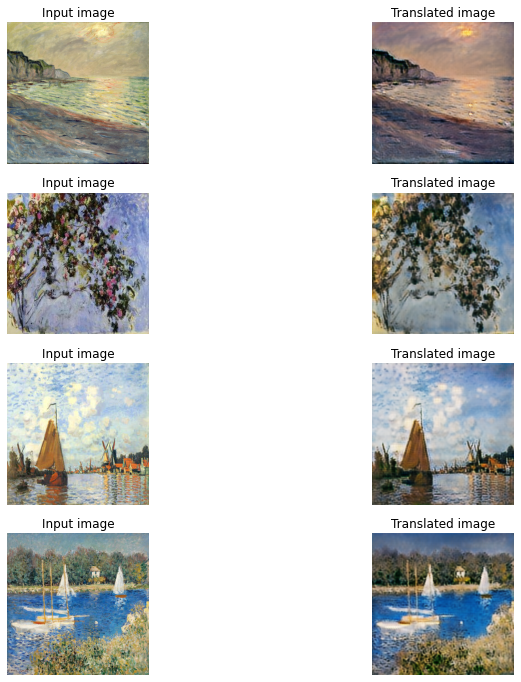

1072/1072 [==============================] - 679s 633ms/step - G_loss: 3.7464 - F_loss: 3.4810 - D_X_loss: 0.2351 - D_Y_loss: 0.2050
Epoch 22/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.7569 - F_loss: 3.4485 - D_X_loss: 0.2359 - D_Y_loss: 0.2024

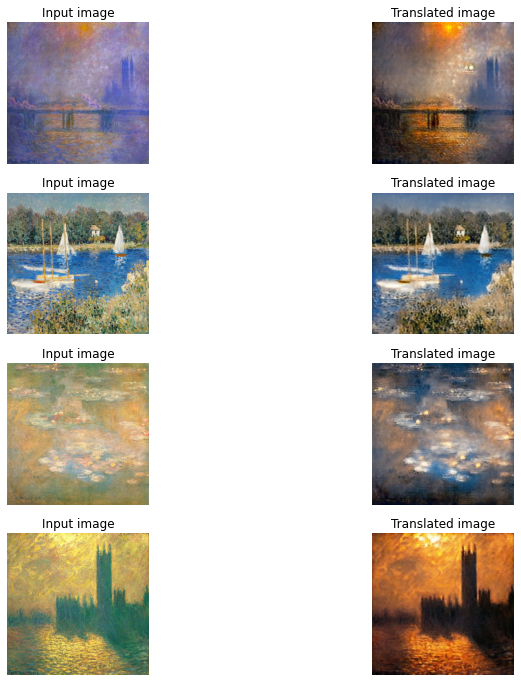

1072/1072 [==============================] - 679s 633ms/step - G_loss: 3.7563 - F_loss: 3.4502 - D_X_loss: 0.2359 - D_Y_loss: 0.2023
Epoch 23/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.7130 - F_loss: 3.3842 - D_X_loss: 0.2342 - D_Y_loss: 0.2057

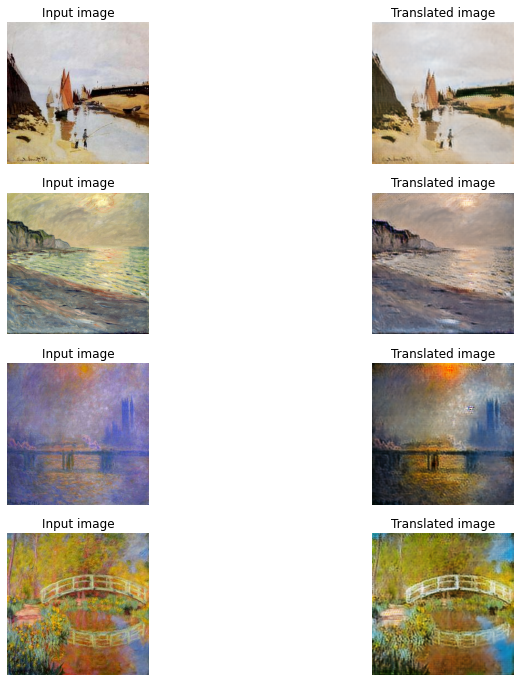

1072/1072 [==============================] - 679s 634ms/step - G_loss: 3.7133 - F_loss: 3.3844 - D_X_loss: 0.2341 - D_Y_loss: 0.2056
Epoch 24/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.7412 - F_loss: 3.3882 - D_X_loss: 0.2342 - D_Y_loss: 0.2045

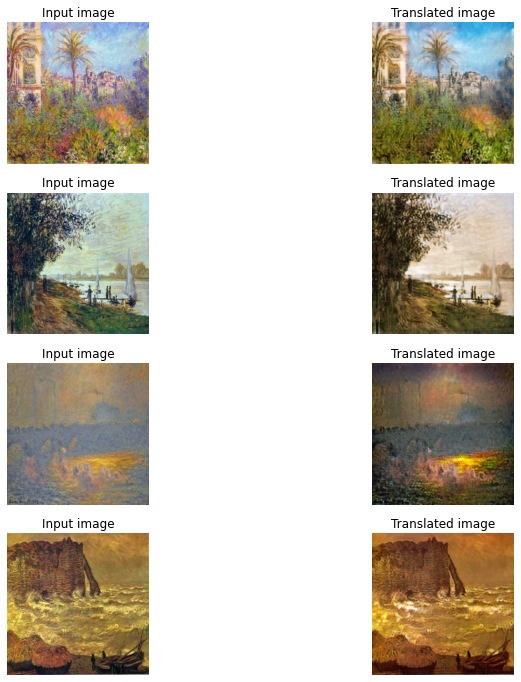

1072/1072 [==============================] - 680s 634ms/step - G_loss: 3.7408 - F_loss: 3.3872 - D_X_loss: 0.2342 - D_Y_loss: 0.2045
Epoch 25/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.7251 - F_loss: 3.3193 - D_X_loss: 0.2332 - D_Y_loss: 0.2029

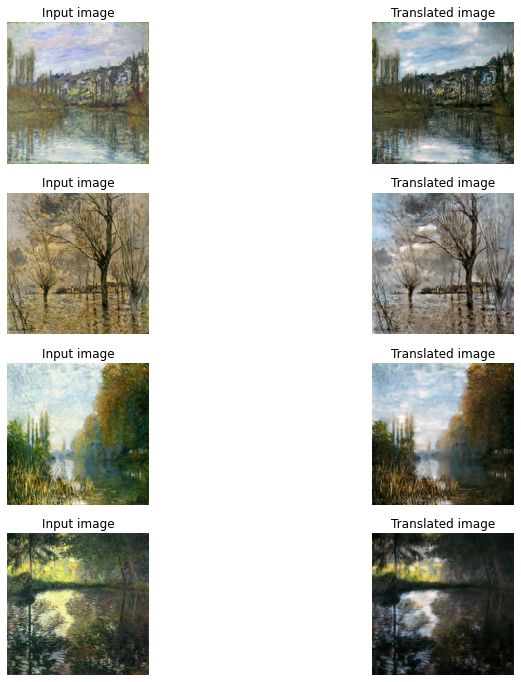

1072/1072 [==============================] - 680s 634ms/step - G_loss: 3.7240 - F_loss: 3.3190 - D_X_loss: 0.2332 - D_Y_loss: 0.2029
Epoch 26/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.6771 - F_loss: 3.2822 - D_X_loss: 0.2319 - D_Y_loss: 0.2050

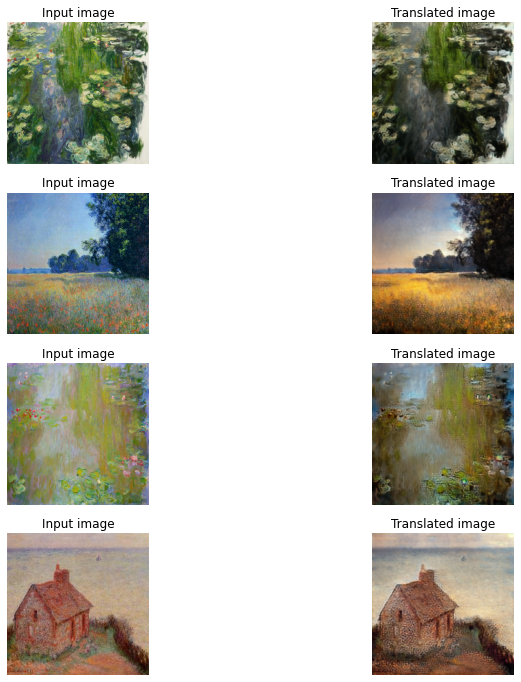

1072/1072 [==============================] - 681s 635ms/step - G_loss: 3.6770 - F_loss: 3.2814 - D_X_loss: 0.2319 - D_Y_loss: 0.2050
Epoch 27/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.6660 - F_loss: 3.2425 - D_X_loss: 0.2317 - D_Y_loss: 0.2031

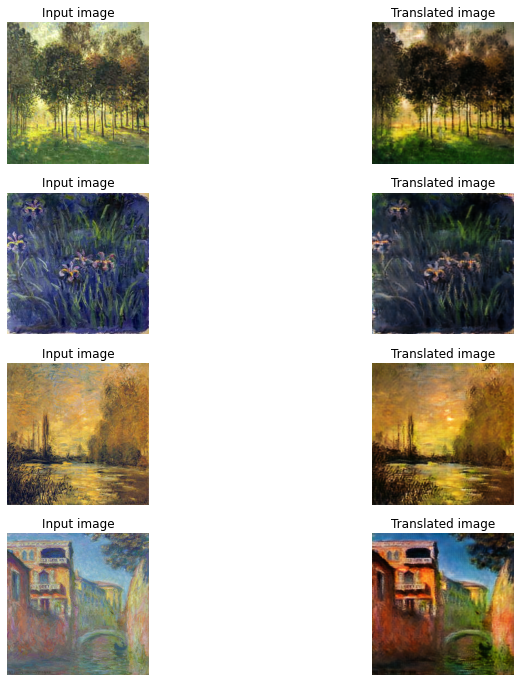

1072/1072 [==============================] - 680s 635ms/step - G_loss: 3.6654 - F_loss: 3.2442 - D_X_loss: 0.2318 - D_Y_loss: 0.2035
Epoch 28/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.6700 - F_loss: 3.1776 - D_X_loss: 0.2332 - D_Y_loss: 0.2031

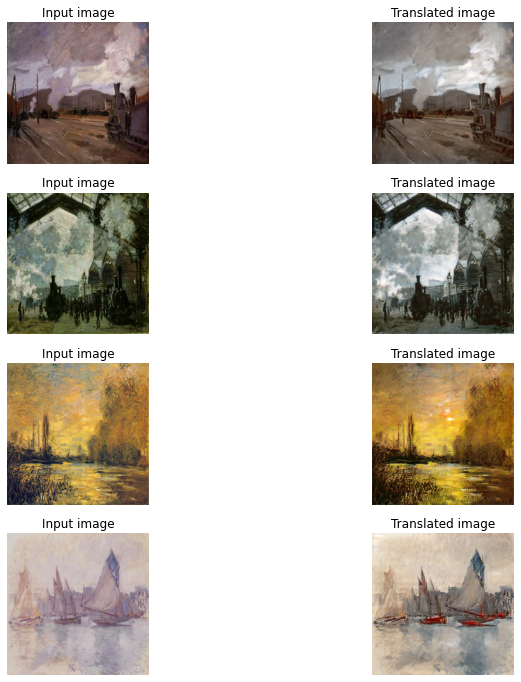

1072/1072 [==============================] - 684s 638ms/step - G_loss: 3.6706 - F_loss: 3.1772 - D_X_loss: 0.2332 - D_Y_loss: 0.2031
Epoch 29/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.6885 - F_loss: 3.1336 - D_X_loss: 0.2299 - D_Y_loss: 0.2031

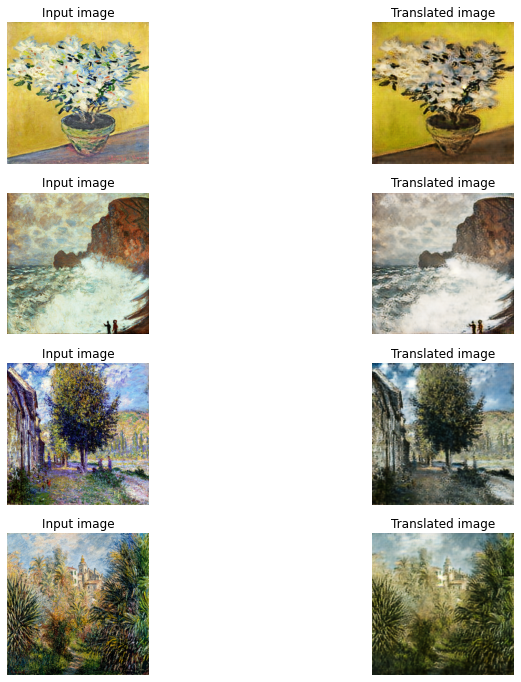

1072/1072 [==============================] - 680s 634ms/step - G_loss: 3.6871 - F_loss: 3.1341 - D_X_loss: 0.2298 - D_Y_loss: 0.2031
Epoch 30/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.6551 - F_loss: 3.1264 - D_X_loss: 0.2305 - D_Y_loss: 0.2051

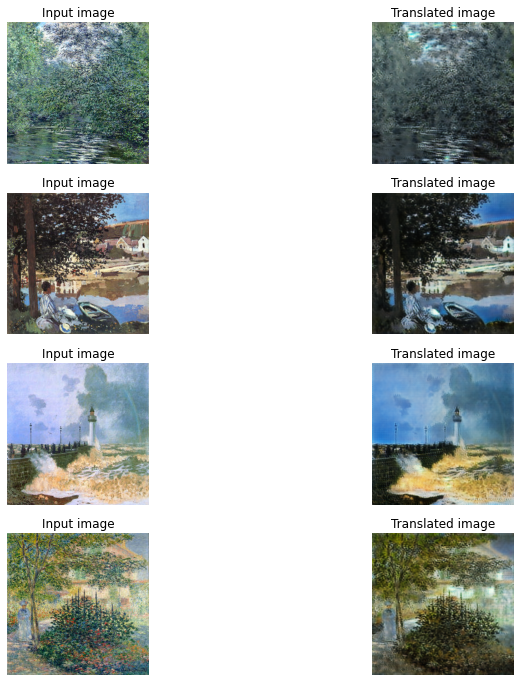

1072/1072 [==============================] - 680s 634ms/step - G_loss: 3.6552 - F_loss: 3.1259 - D_X_loss: 0.2305 - D_Y_loss: 0.2049
Epoch 31/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.6140 - F_loss: 3.0566 - D_X_loss: 0.2306 - D_Y_loss: 0.2041

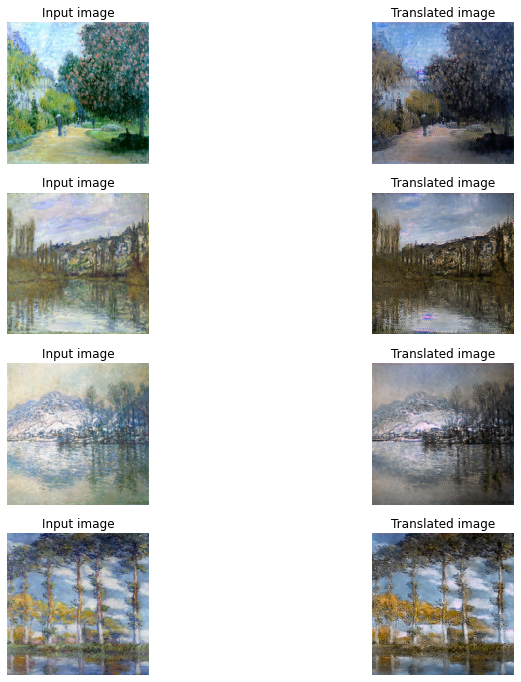

1072/1072 [==============================] - 681s 635ms/step - G_loss: 3.6149 - F_loss: 3.0568 - D_X_loss: 0.2306 - D_Y_loss: 0.2040
Epoch 32/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.5759 - F_loss: 3.0048 - D_X_loss: 0.2300 - D_Y_loss: 0.2054

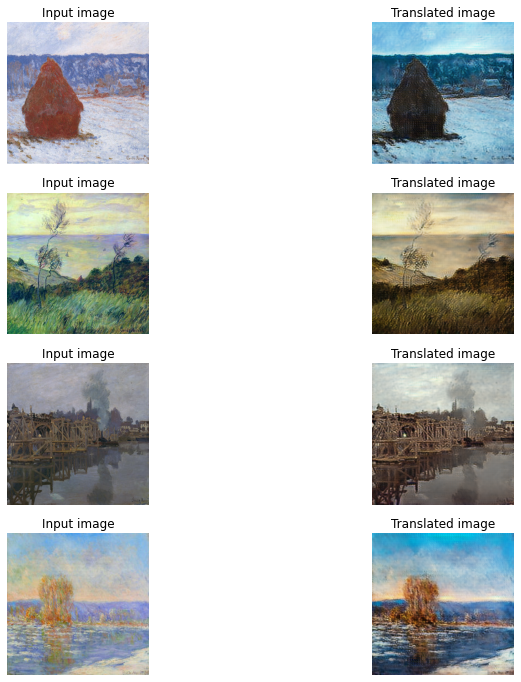

1072/1072 [==============================] - 679s 634ms/step - G_loss: 3.5790 - F_loss: 3.0043 - D_X_loss: 0.2301 - D_Y_loss: 0.2054
Epoch 33/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.5644 - F_loss: 3.0234 - D_X_loss: 0.2307 - D_Y_loss: 0.2041

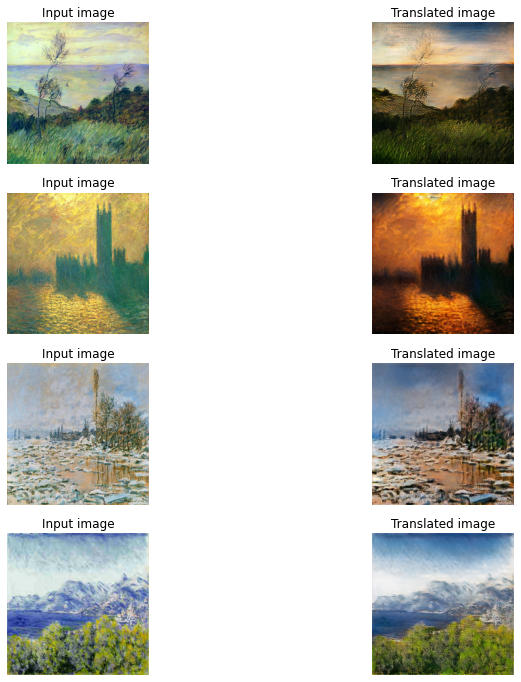

1072/1072 [==============================] - 682s 636ms/step - G_loss: 3.5643 - F_loss: 3.0248 - D_X_loss: 0.2306 - D_Y_loss: 0.2041
Epoch 34/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.5823 - F_loss: 2.9556 - D_X_loss: 0.2297 - D_Y_loss: 0.2030

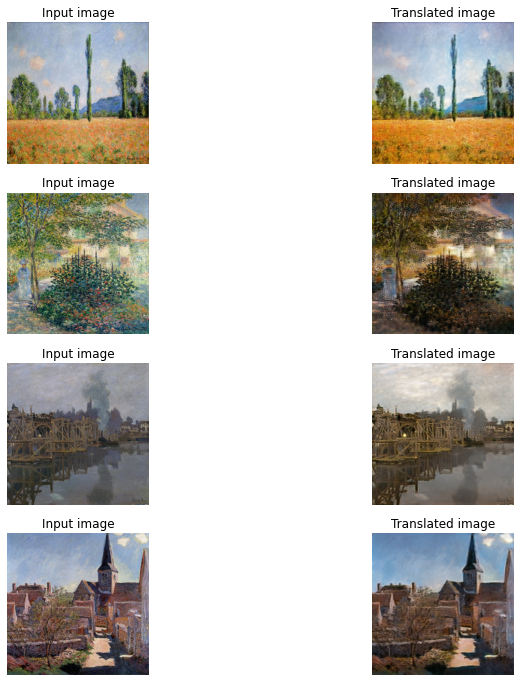

1072/1072 [==============================] - 694s 648ms/step - G_loss: 3.5812 - F_loss: 2.9570 - D_X_loss: 0.2296 - D_Y_loss: 0.2030
Epoch 35/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.5863 - F_loss: 2.9311 - D_X_loss: 0.2295 - D_Y_loss: 0.2062

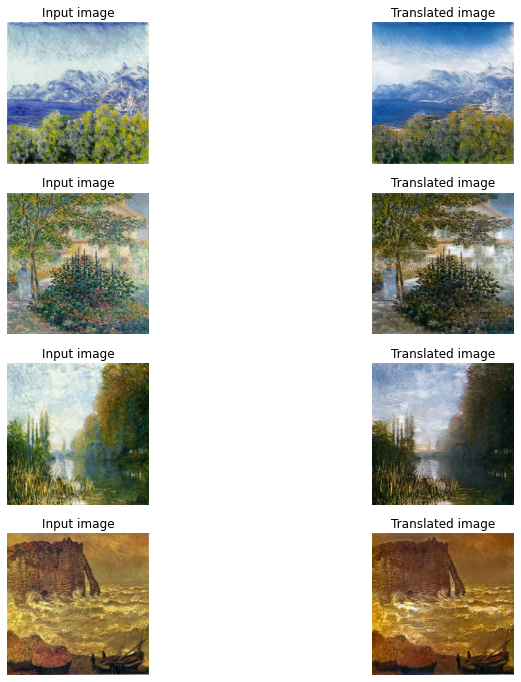

1072/1072 [==============================] - 681s 635ms/step - G_loss: 3.5860 - F_loss: 2.9304 - D_X_loss: 0.2296 - D_Y_loss: 0.2062
Epoch 36/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.5487 - F_loss: 2.8704 - D_X_loss: 0.2289 - D_Y_loss: 0.2037

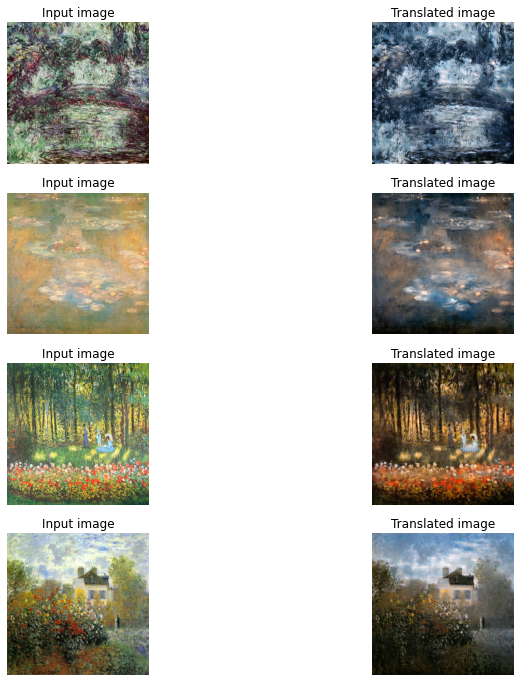

1072/1072 [==============================] - 693s 646ms/step - G_loss: 3.5471 - F_loss: 2.8704 - D_X_loss: 0.2288 - D_Y_loss: 0.2036
Epoch 37/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.5448 - F_loss: 2.8608 - D_X_loss: 0.2285 - D_Y_loss: 0.1991

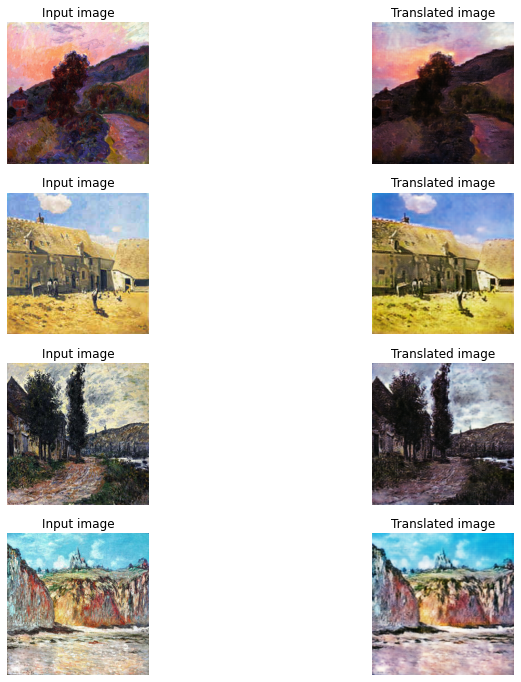

1072/1072 [==============================] - 679s 633ms/step - G_loss: 3.5454 - F_loss: 2.8623 - D_X_loss: 0.2284 - D_Y_loss: 0.1991
Epoch 38/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.5387 - F_loss: 2.8809 - D_X_loss: 0.2265 - D_Y_loss: 0.1815

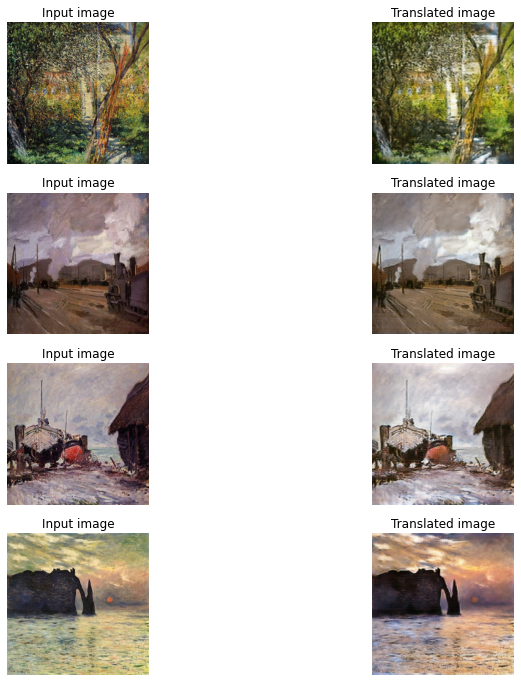

1072/1072 [==============================] - 679s 633ms/step - G_loss: 3.5377 - F_loss: 2.8804 - D_X_loss: 0.2265 - D_Y_loss: 0.1815
Epoch 39/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.5625 - F_loss: 2.8447 - D_X_loss: 0.2259 - D_Y_loss: 0.1742

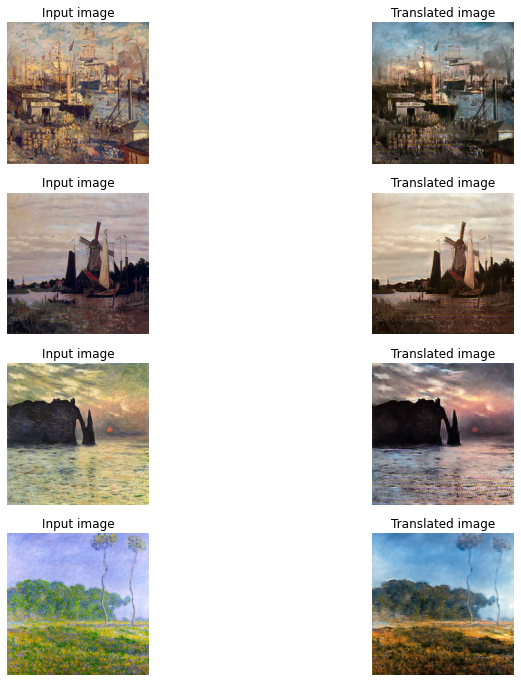

1072/1072 [==============================] - 680s 634ms/step - G_loss: 3.5617 - F_loss: 2.8451 - D_X_loss: 0.2259 - D_Y_loss: 0.1742
Epoch 40/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.6191 - F_loss: 2.7966 - D_X_loss: 0.2243 - D_Y_loss: 0.1628

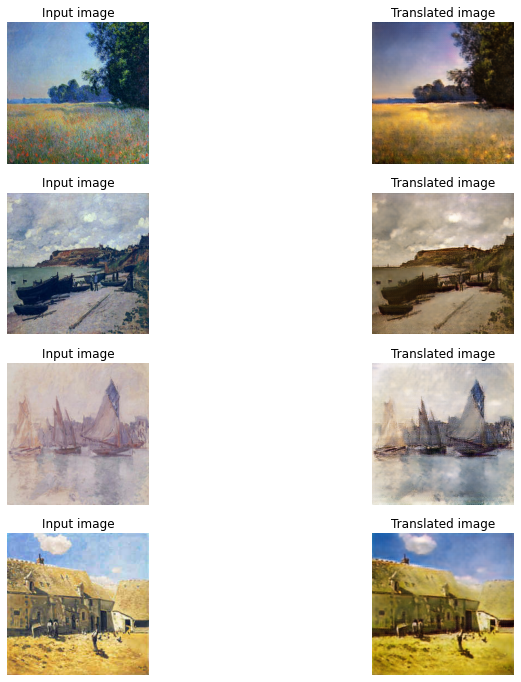

1072/1072 [==============================] - 680s 635ms/step - G_loss: 3.6184 - F_loss: 2.7962 - D_X_loss: 0.2243 - D_Y_loss: 0.1627
Epoch 41/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.6410 - F_loss: 2.7562 - D_X_loss: 0.2248 - D_Y_loss: 0.1630

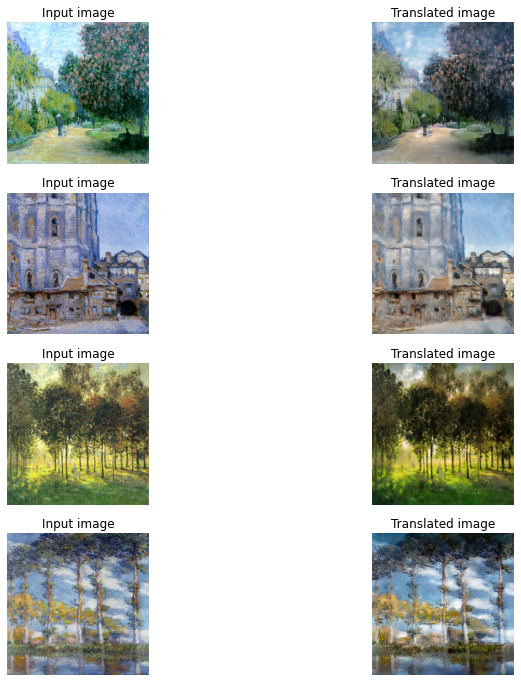

1072/1072 [==============================] - 679s 634ms/step - G_loss: 3.6416 - F_loss: 2.7569 - D_X_loss: 0.2247 - D_Y_loss: 0.1630
Epoch 42/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.5921 - F_loss: 2.7928 - D_X_loss: 0.2247 - D_Y_loss: 0.1631

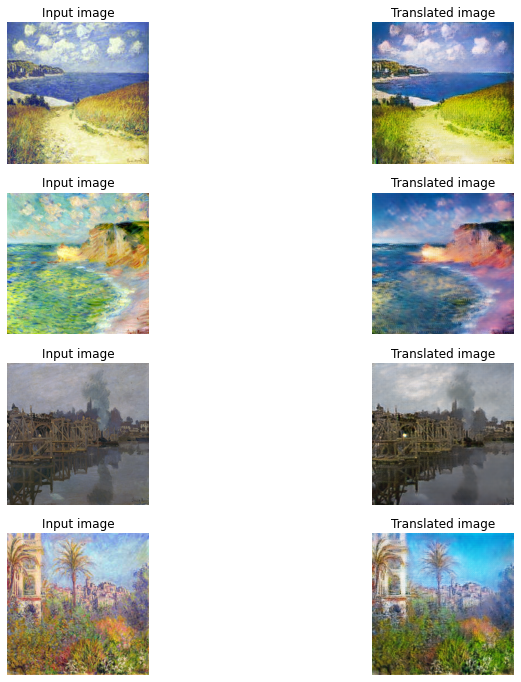

1072/1072 [==============================] - 682s 636ms/step - G_loss: 3.5914 - F_loss: 2.7925 - D_X_loss: 0.2248 - D_Y_loss: 0.1631
Epoch 43/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.5406 - F_loss: 2.7573 - D_X_loss: 0.2236 - D_Y_loss: 0.1666

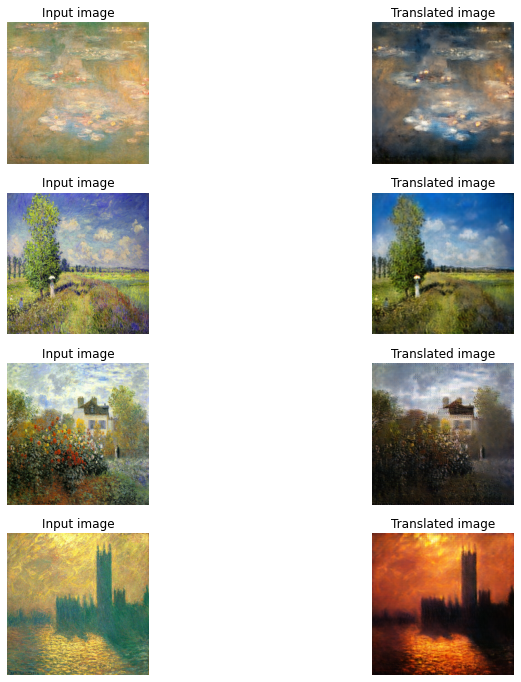

1072/1072 [==============================] - 680s 634ms/step - G_loss: 3.5402 - F_loss: 2.7574 - D_X_loss: 0.2236 - D_Y_loss: 0.1666
Epoch 44/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.5104 - F_loss: 2.7167 - D_X_loss: 0.2220 - D_Y_loss: 0.2070

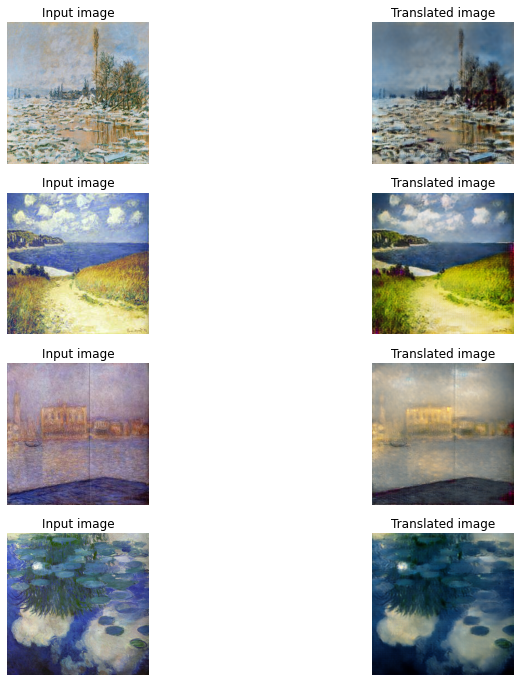

1072/1072 [==============================] - 679s 633ms/step - G_loss: 3.5095 - F_loss: 2.7175 - D_X_loss: 0.2221 - D_Y_loss: 0.2070
Epoch 45/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.4153 - F_loss: 2.6723 - D_X_loss: 0.2237 - D_Y_loss: 0.2170

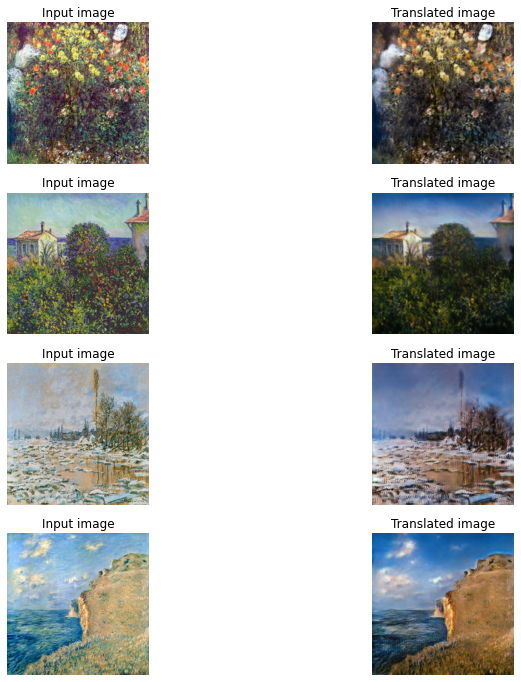

1072/1072 [==============================] - 680s 634ms/step - G_loss: 3.4149 - F_loss: 2.6720 - D_X_loss: 0.2237 - D_Y_loss: 0.2169
Epoch 46/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.4257 - F_loss: 2.6974 - D_X_loss: 0.2214 - D_Y_loss: 0.2153

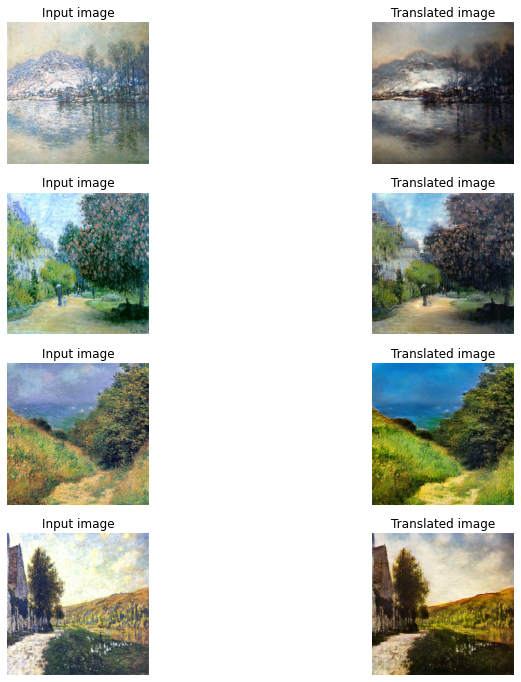

1072/1072 [==============================] - 681s 635ms/step - G_loss: 3.4265 - F_loss: 2.6973 - D_X_loss: 0.2213 - D_Y_loss: 0.2154
Epoch 47/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.3901 - F_loss: 2.6867 - D_X_loss: 0.2180 - D_Y_loss: 0.2126

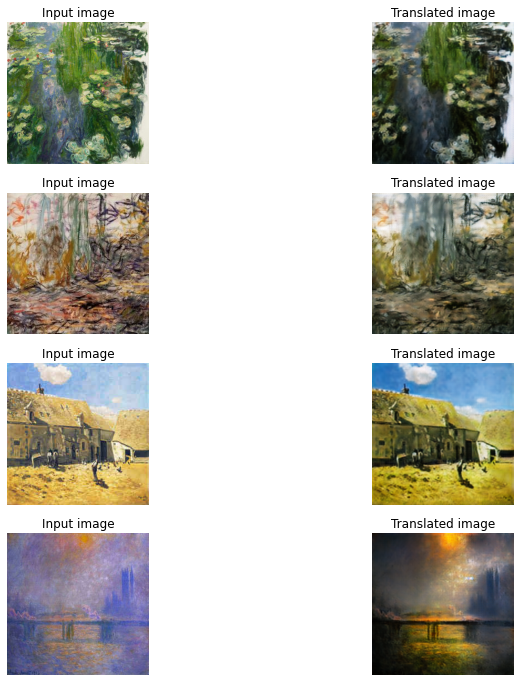

1072/1072 [==============================] - 680s 634ms/step - G_loss: 3.3901 - F_loss: 2.6878 - D_X_loss: 0.2179 - D_Y_loss: 0.2126
Epoch 48/70
1072/1072 [==============================] - ETA: 0s - G_loss: 3.4209 - F_loss: 2.6561 - D_X_loss: 0.2189 - D_Y_loss: 0.2121

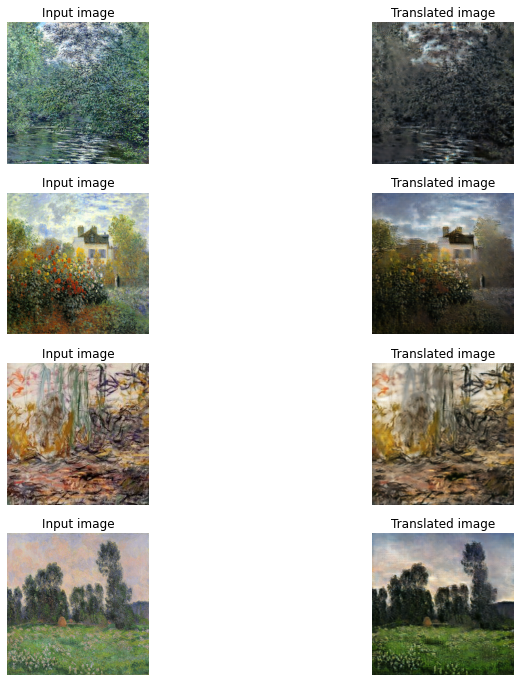

1072/1072 [==============================] - 680s 635ms/step - G_loss: 3.4202 - F_loss: 2.6556 - D_X_loss: 0.2188 - D_Y_loss: 0.2120
Epoch 49/70
 864/1072 [=======================>......] - ETA: 2:11 - G_loss: 3.3025 - F_loss: 2.6270 - D_X_loss: 0.2165 - D_Y_loss: 0.2103

In [ ]:
# Here we will train the model for just one epoch as each epoch takes around
# 7 minutes on a single P100 backed machine.
cycle_gan_model.fit(
    tf.data.Dataset.zip((train_monet, train_photo)),
    epochs=70,
    callbacks=[plotter, model_checkpoint_callback],
)

In [ ]:
# This model was trained for 90 epochs. We will be loading those weights
# here. Once the weights are loaded, we will take a few samples from the test
# data and check the model's performance.

In [ ]:
# !curl -LO https://github.com/AakashKumarNain/CycleGAN_TF2/releases/download/v1.0/saved_checkpoints.zip
# !unzip -qq saved_checkpoints.zip -d /content/drive/MyDrive/CycleGAN/pre-trained

In [ ]:
# Load the checkpoints
weight_file = "/content/drive/MyDrive/CycleGAN/pre-trained/saved_checkpoints/cyclegan_checkpoints.090"
cycle_gan_model.load_weights(weight_file).expect_partial()
print("Weights loaded successfully")

_, ax = plt.subplots(4, 2, figsize=(10, 15))
for i, img in enumerate(test_photo.take(4)):
    prediction = cycle_gan_model.gen_G(img, training=False)[0].numpy()
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
    img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

    ax[i, 0].imshow(img)
    ax[i, 1].imshow(prediction)
    ax[i, 0].set_title("Input image")
    ax[i, 0].set_title("Input image")
    ax[i, 1].set_title("Translated image")
    ax[i, 0].axis("off")
    ax[i, 1].axis("off")

    prediction = keras.preprocessing.image.array_to_img(prediction)
    prediction.save("/content/drive/MyDrive/CycleGAN/photo/predicted_img_{i}.png".format(i=i))
plt.tight_layout()
plt.show()

In [ ]:
_, ax = plt.subplots(2, figsize=(10, 15))
image = tf.keras.preprocessing.image.load_img('/content/drive/MyDrive/CycleGAN/wallpapersden.com_evening-in-semarang-city-indonesia_128x128.jpg')
input_arr = keras.preprocessing.image.img_to_array(image)
input_arr = np.array([input_arr])  # Convert single image to a batch.
prediction = cycle_gan_model.gen_G(input_arr, training=False)[0].numpy()
prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
img = (input_arr[0] * 127.5 + 127.5).astype(np.uint8)

ax[0].imshow(image)
ax[1].imshow(prediction)
ax[0].set_title("Input image")
ax[1].set_title("Translated image")
ax[0].axis("off")
ax[1].axis("off")

prediction = keras.preprocessing.image.array_to_img(prediction)
prediction.save("/content/drive/MyDrive/CycleGAN/photo/predicted_img_{i}.png".format(i=0))
plt.tight_layout()
plt.show()

Weights loaded successfully


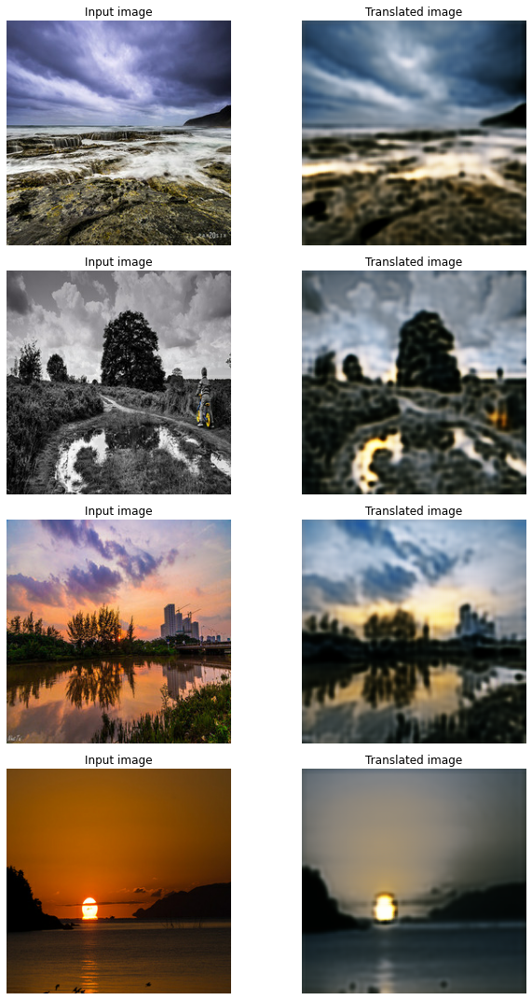

In [ ]:
# Load the checkpoints
weight_file = "/content/drive/MyDrive/CycleGAN/pre-trained/cyclegan_checkpoints.001"
cycle_gan_model.load_weights(weight_file).expect_partial()
print("Weights loaded successfully")

_, ax = plt.subplots(4, 2, figsize=(10, 15))
for i, img in enumerate(test_photo.take(4)):
    prediction = cycle_gan_model.gen_G(img, training=False)[0].numpy()
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
    img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

    ax[i, 0].imshow(img)
    ax[i, 1].imshow(prediction)
    ax[i, 0].set_title("Input image")
    ax[i, 0].set_title("Input image")
    ax[i, 1].set_title("Translated image")
    ax[i, 0].axis("off")
    ax[i, 1].axis("off")

    prediction = keras.preprocessing.image.array_to_img(prediction)
    prediction.save("/content/drive/MyDrive/CycleGAN/photo/predicted_img_{i}.png".format(i=i))
plt.tight_layout()
plt.show()

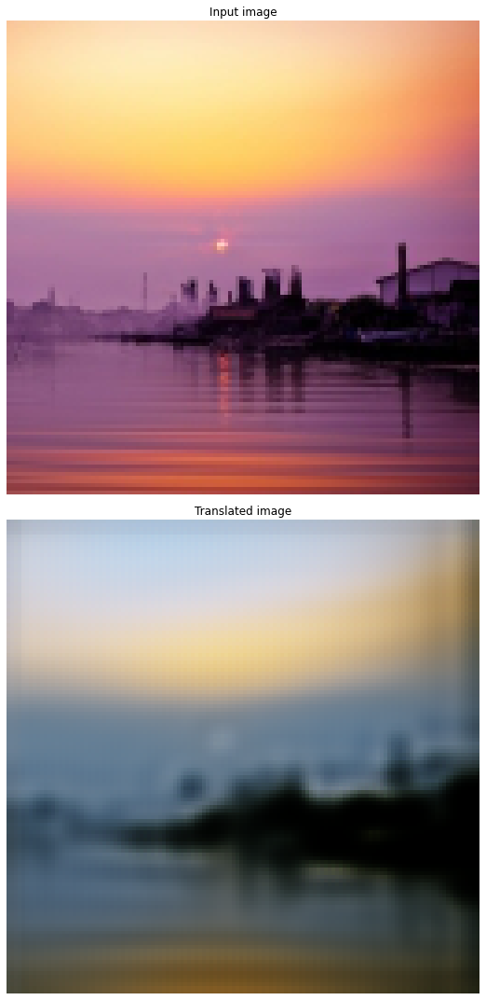

In [ ]:
_, ax = plt.subplots(2, figsize=(10, 15))
image = tf.keras.preprocessing.image.load_img('/content/drive/MyDrive/CycleGAN/wallpapersden.com_evening-in-semarang-city-indonesia_128x128.jpg')
input_arr = keras.preprocessing.image.img_to_array(image)
input_arr = np.array([input_arr])  # Convert single image to a batch.
prediction = cycle_gan_model.gen_G(input_arr, training=False)[0].numpy()
prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
img = (input_arr[0] * 127.5 + 127.5).astype(np.uint8)

ax[0].imshow(image)
ax[1].imshow(prediction)
ax[0].set_title("Input image")
ax[1].set_title("Translated image")
ax[0].axis("off")
ax[1].axis("off")

prediction = keras.preprocessing.image.array_to_img(prediction)
prediction.save("/content/drive/MyDrive/CycleGAN/photo/predicted_img_{i}.png".format(i=0))
plt.tight_layout()
plt.show()

In [ ]:
!pip3 freeze > /content/drive/MyDrive/CycleGAN/requirements.txt

Weights loaded successfully
Epoch 1/7
1072/1072 [==============================] - ETA: 0s - G_loss: 3.9059 - F_loss: 3.6674 - D_X_loss: 0.2348 - D_Y_loss: 0.2081

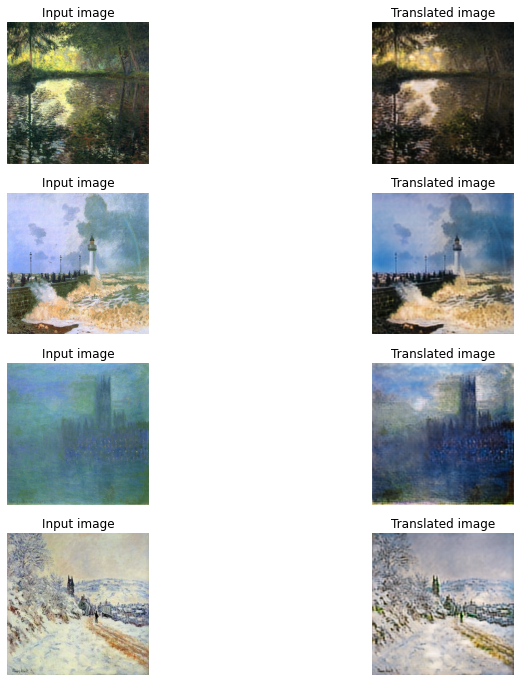

1072/1072 [==============================] - 684s 638ms/step - G_loss: 3.9045 - F_loss: 3.6674 - D_X_loss: 0.2348 - D_Y_loss: 0.2081
Epoch 2/7
1072/1072 [==============================] - ETA: 0s - G_loss: 3.8442 - F_loss: 3.5950 - D_X_loss: 0.2343 - D_Y_loss: 0.2078

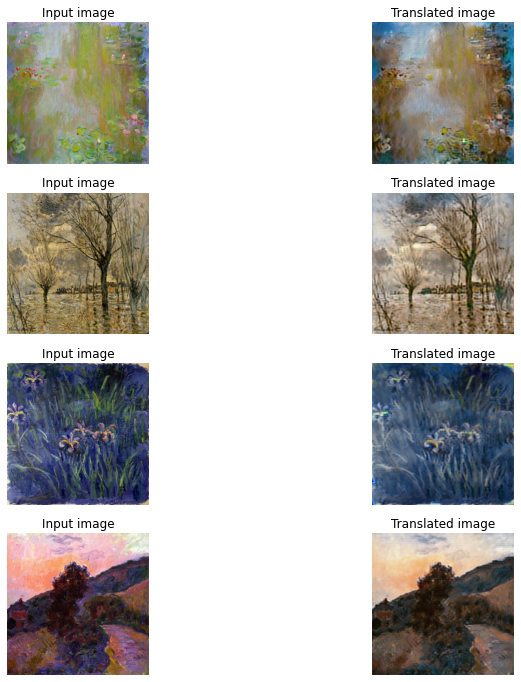

1072/1072 [==============================] - 693s 647ms/step - G_loss: 3.8462 - F_loss: 3.5952 - D_X_loss: 0.2343 - D_Y_loss: 0.2078
Epoch 3/7
 878/1072 [=======================>......] - ETA: 2:04 - G_loss: 3.8775 - F_loss: 3.5748 - D_X_loss: 0.2374 - D_Y_loss: 0.2065

In [ ]:
# Continuously training 7 epochs after 48 epochs -> 55 epochs
# Load the checkpoints
weight_file = "/content/drive/MyDrive/CycleGAN/pre-trained/cyclegan_checkpoints.015"
cycle_gan_model.load_weights(weight_file).expect_partial()
print("Weights loaded successfully")

# Here we will train the model for just one epoch as each epoch takes around
# 7 minutes on a single P100 backed machine.
cycle_gan_model.fit(
    tf.data.Dataset.zip((train_monet, train_photo)),
    epochs=7,
    callbacks=[plotter, model_checkpoint_callback],
)

In [12]:
# Load the checkpoints
weight_file = "D:/WorkStudy/Coding/ComputerVision/Project/pre-trained/cyclegan_checkpoints.003"
cycle_gan_model.load_weights(weight_file).expect_partial()
print("Weights loaded successfully")

Weights loaded successfully


In [21]:
print(cycle_gan_model)